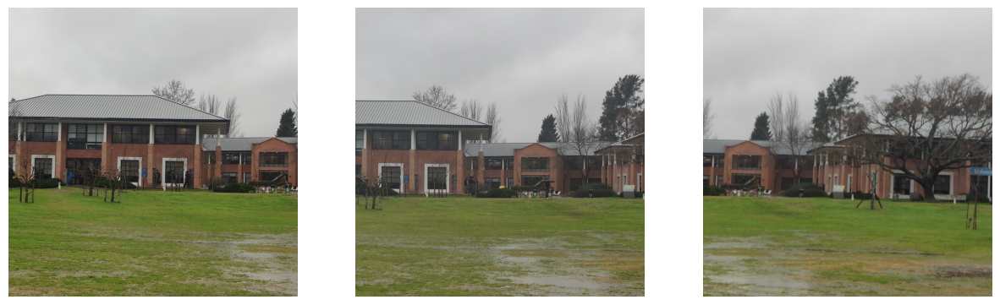

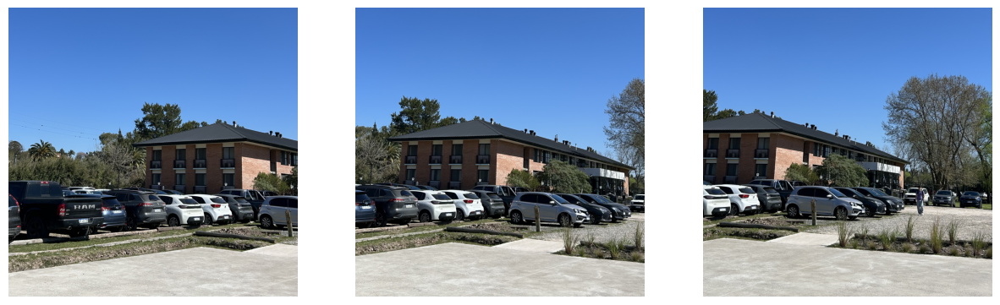

In [1]:


import cv2
import os
import matplotlib.pyplot as plt
import numpy as np

# Ruta de la carpeta que contiene las imágenes
carpeta_imagenes = 'img'

udesa_0 = cv2.imread(os.path.join(carpeta_imagenes, 'udesa_0.jpg'))
udesa_1 = cv2.imread(os.path.join(carpeta_imagenes, 'udesa_1.jpg'))
udesa_2 = cv2.imread(os.path.join(carpeta_imagenes, 'udesa_2.jpg'))

edi_0 = cv2.imread(os.path.join(carpeta_imagenes, 'edi_0.jpg'))
edi_1 = cv2.imread(os.path.join(carpeta_imagenes, 'edi_1.jpg'))
edi_2 = cv2.imread(os.path.join(carpeta_imagenes, 'edi_2.jpg'))

#graficar las imagenes una al lado de la otra
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(udesa_0, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 2)
plt.imshow(cv2.cvtColor(udesa_1, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(udesa_2, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(edi_0, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 2) 
plt.imshow(cv2.cvtColor(edi_1, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(edi_2, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()


# Detección y descripición de características visuales


Imagen 0: 22107 keypoints detectados
Imagen 1: 14852 keypoints detectados
Imagen 2: 5363 keypoints detectados


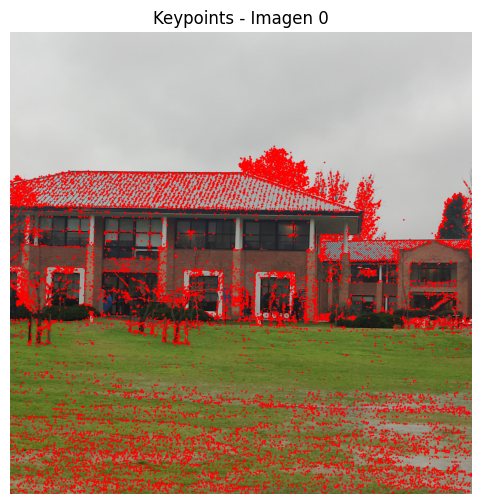

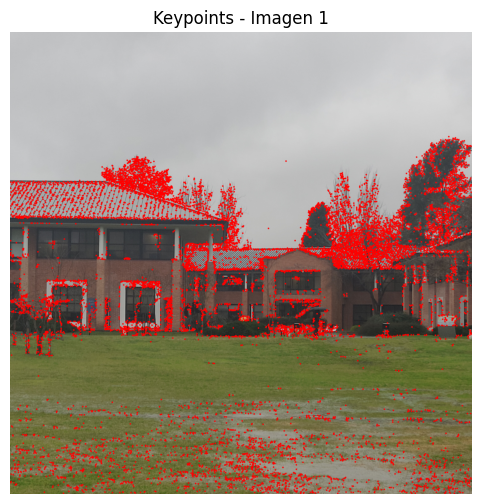

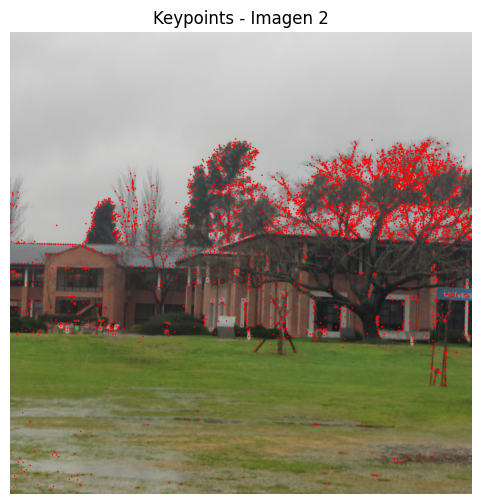

Imagen Cuadro 0: 22000 keypoints detectados
Imagen Cuadro 1: 22000 keypoints detectados
Imagen Cuadro 2: 22001 keypoints detectados


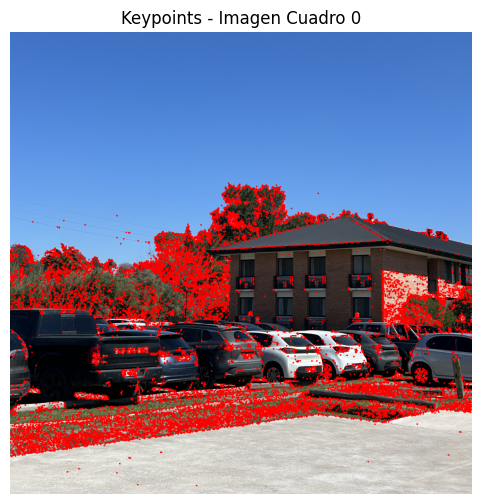

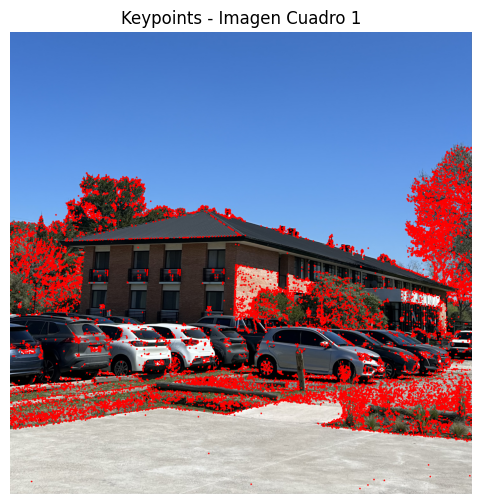

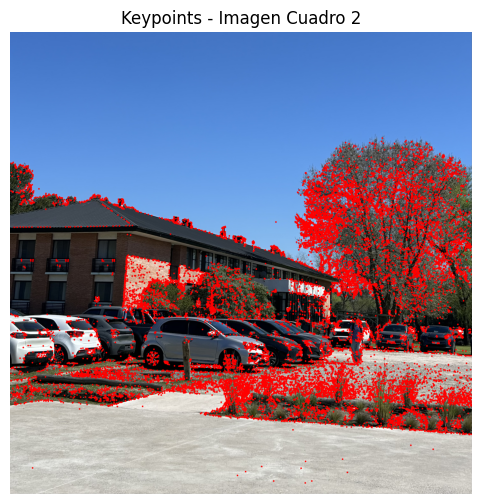

In [2]:
import cv2
import matplotlib.pyplot as plt

def detectar_descriptores(imagen, metodo="ORB", nfeatures=500):
    """
    Detecta keypoints y calcula descriptores de una imagen.
    
    Args:
        imagen (np.array): imagen cargada con cv2.imread
        metodo (str): "SIFT" o "ORB"
        nfeatures (int): cantidad máxima de features
    
    Returns:
        keypoints, descriptors
    """
    if metodo.upper() == "SIFT":
        detector = cv2.SIFT_create(nfeatures=nfeatures)
    elif metodo.upper() == "ORB":
        detector = cv2.ORB_create(nfeatures=nfeatures)
    else:
        raise ValueError("Método no soportado. Usar 'SIFT' u 'ORB'.")

    # detección + descripción en un solo paso
    keypoints, descriptors = detector.detectAndCompute(imagen, None)
    return keypoints, descriptors

def mostrar_keypoints(imagen, keypoints, titulo="Keypoints"):
    img_kp = imagen.copy()
    for kp in keypoints:
        x, y = map(int, kp.pt)
        cv2.circle(img_kp, (x, y), 5, (0,0,255), -1)  # círculos rojos
    plt.figure(figsize=(8,6))
    plt.imshow(cv2.cvtColor(img_kp, cv2.COLOR_BGR2RGB))
    plt.title(titulo)
    plt.axis("off")
    plt.show()

# Detectar descriptores en cada imagen con ORB
kp0, des0 = detectar_descriptores(udesa_0, metodo="SIFT", nfeatures=50000)
kp1, des1 = detectar_descriptores(udesa_1, metodo="SIFT", nfeatures=50000)
kp2, des2 = detectar_descriptores(udesa_2, metodo="SIFT", nfeatures=50000)

print(f"Imagen 0: {len(kp0)} keypoints detectados")
print(f"Imagen 1: {len(kp1)} keypoints detectados")
print(f"Imagen 2: {len(kp2)} keypoints detectados")

# Mostrar imágenes con keypoints dibujados
mostrar_keypoints(udesa_0, kp0, "Keypoints - Imagen 0")
mostrar_keypoints(udesa_1, kp1, "Keypoints - Imagen 1")
mostrar_keypoints(udesa_2, kp2, "Keypoints - Imagen 2")

kp0_edi, des0_edi = detectar_descriptores(edi_0, metodo="SIFT", nfeatures=22000)
kp1_edi, des1_edi = detectar_descriptores(edi_1, metodo="SIFT", nfeatures=22000)
kp2_edi, des2_edi = detectar_descriptores(edi_2, metodo="SIFT", nfeatures=22000)
print(f"Imagen Cuadro 0: {len(kp0_edi)} keypoints detectados")
print(f"Imagen Cuadro 1: {len(kp1_edi)} keypoints detectados")
print(f"Imagen Cuadro 2: {len(kp2_edi)} keypoints detectados")
mostrar_keypoints(edi_0, kp0_edi, "Keypoints - Imagen Cuadro 0")
mostrar_keypoints(edi_1, kp1_edi, "Keypoints - Imagen Cuadro 1")
mostrar_keypoints(edi_2, kp2_edi, "Keypoints - Imagen Cuadro 2")


# 3.2.  Supresión de No Máxima Adaptativa

Imagen 0: 800 keypoints tras ANMS
Imagen 1: 800 keypoints tras ANMS
Imagen 2: 800 keypoints tras ANMS


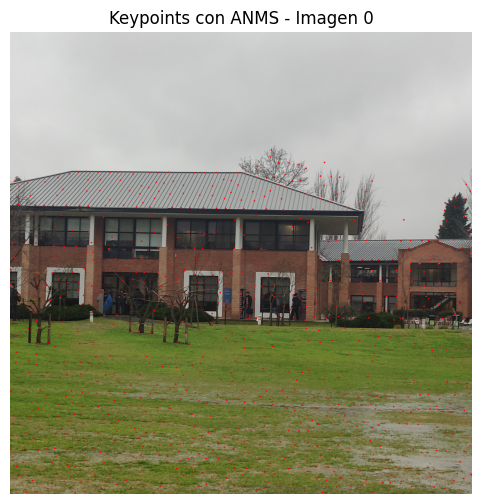

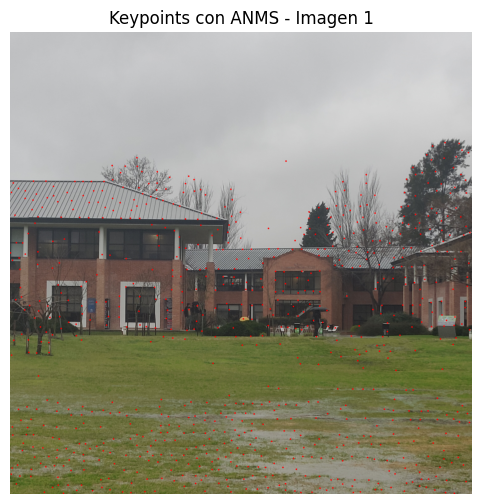

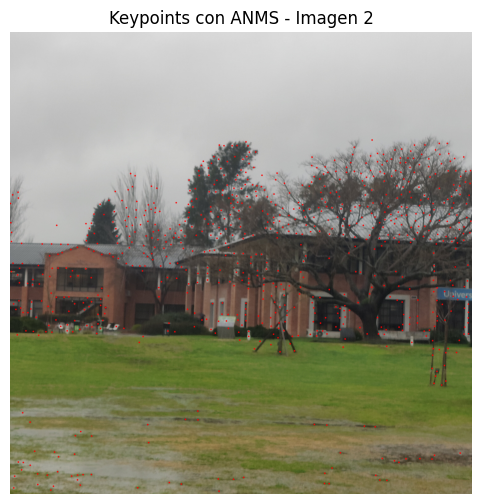

Imagen Cuadro 0: 800 keypoints tras ANMS
Imagen Cuadro 1: 800 keypoints tras ANMS
Imagen Cuadro   2: 800 keypoints tras ANMS


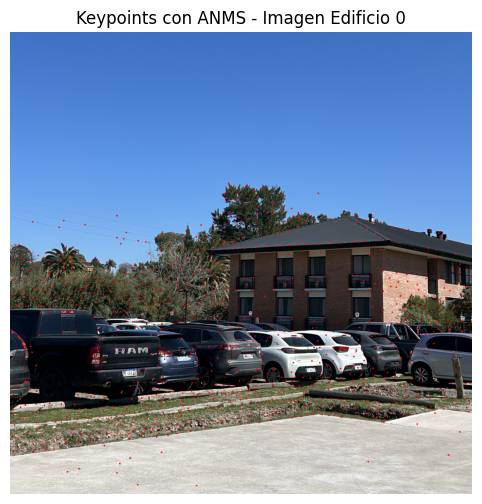

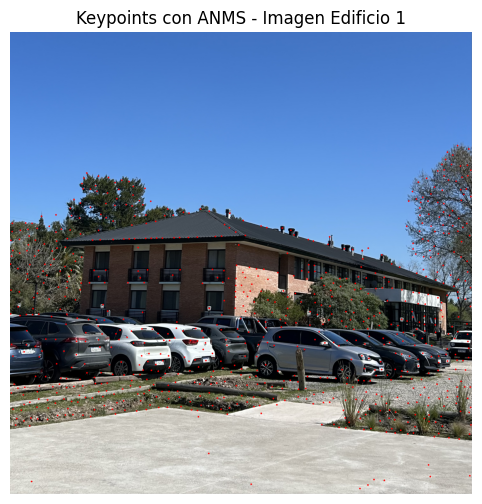

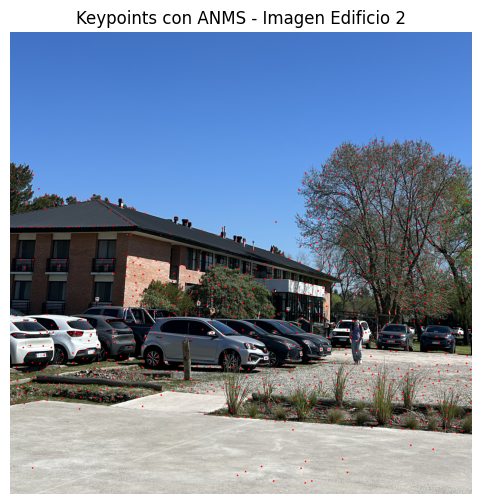

In [3]:

import numpy as np
from scipy.spatial import cKDTree

def aplicar_ANMS(keypoints, N=500):
    """
    ANMS rápido usando KD-Tree.
    
    Args:
        keypoints: lista de cv2.KeyPoint detectados
        N: cantidad máxima de puntos a conservar
    
    Returns:
        keypoints_filtrados: lista reducida de keypoints
    """
    if len(keypoints) <= N:
        return keypoints

    # Extraer coordenadas y respuestas
    coords = np.array([kp.pt for kp in keypoints])
    respuestas = np.array([kp.response for kp in keypoints])

    # Ordenar por respuesta descendente
    idx_sorted = np.argsort(-respuestas)
    coords_sorted = coords[idx_sorted]
    respuestas_sorted = respuestas[idx_sorted]

    # KDTree para búsquedas rápidas
    tree = cKDTree(coords_sorted)

    # Radios inicializados en infinito
    radios = np.full(len(coords_sorted), np.inf)

    # Para cada punto (menos fuerte), buscar el vecino más cercano más fuerte
    for i in range(1, len(coords_sorted)):
        # vecinos más fuertes son los anteriores en el orden
        d, j = tree.query(coords_sorted[i], k=i)  
        radios[i] = np.min(np.sum((coords_sorted[i] - coords_sorted[:i])**2, axis=1))

    # Ordenar por radio descendente
    idx_final = np.argsort(-radios)

    # Seleccionar top N
    seleccionados_idx = idx_final[:N]
    seleccionados = [keypoints[idx_sorted[i]] for i in seleccionados_idx]

    return seleccionados



# Aplicar ANMS para quedarnos con 800 bien distribuidos
kp0_anms = aplicar_ANMS(kp0, N=800)
kp1_anms = aplicar_ANMS(kp1, N=800)
kp2_anms = aplicar_ANMS(kp2, N=800)

print(f"Imagen 0: {len(kp0_anms)} keypoints tras ANMS")
print(f"Imagen 1: {len(kp1_anms)} keypoints tras ANMS")
print(f"Imagen 2: {len(kp2_anms)} keypoints tras ANMS")
# Visualizar resultado
mostrar_keypoints(udesa_0, kp0_anms, "Keypoints con ANMS - Imagen 0")
mostrar_keypoints(udesa_1, kp1_anms, "Keypoints con ANMS - Imagen 1")
mostrar_keypoints(udesa_2, kp2_anms, "Keypoints con ANMS - Imagen 2")

kp0_edi_anms = aplicar_ANMS(kp0_edi, N=800)
kp1_edi_anms = aplicar_ANMS(kp1_edi, N=800)
kp2_edi_anms = aplicar_ANMS(kp2_edi, N=800)

print(f"Imagen Cuadro 0: {len(kp0_edi_anms)} keypoints tras ANMS")
print(f"Imagen Cuadro 1: {len(kp1_edi_anms)} keypoints tras ANMS")
print(f"Imagen Cuadro   2: {len(kp2_edi_anms)} keypoints tras ANMS")
mostrar_keypoints(edi_0, kp0_edi_anms, "Keypoints con ANMS - Imagen Edificio 0")
mostrar_keypoints(edi_1, kp1_edi_anms, "Keypoints con ANMS - Imagen Edificio 1")
mostrar_keypoints(edi_2, kp2_edi_anms, "Keypoints con ANMS - Imagen Edificio 2")


# ASOCIACIÓN DE CARACTERÍSTICAS

Imagen 0: 1013 puntos tras ANMS
Imagen 1: 1012 puntos tras ANMS
Imagen 2: 1010 puntos tras ANMS
Matches entre 0 y 1: 93
Matches entre 2 y 1: 25


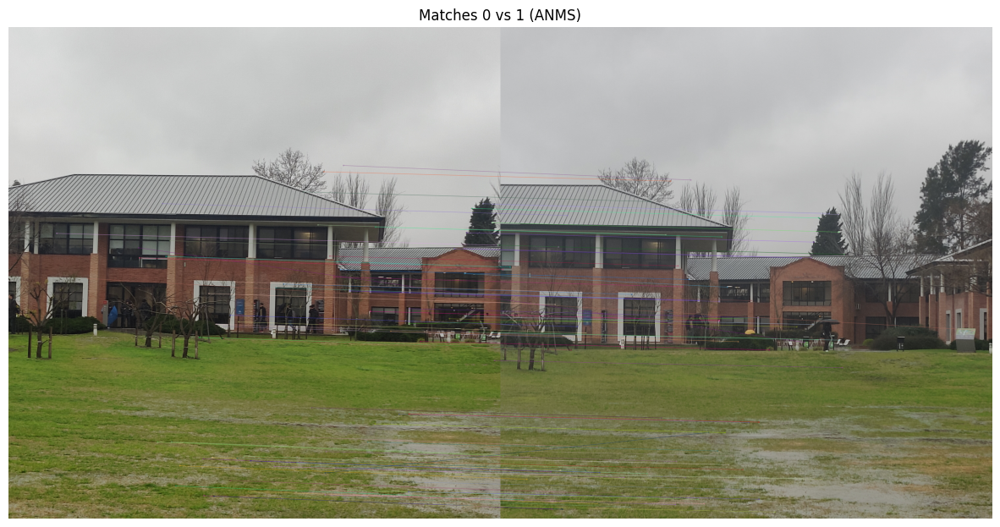

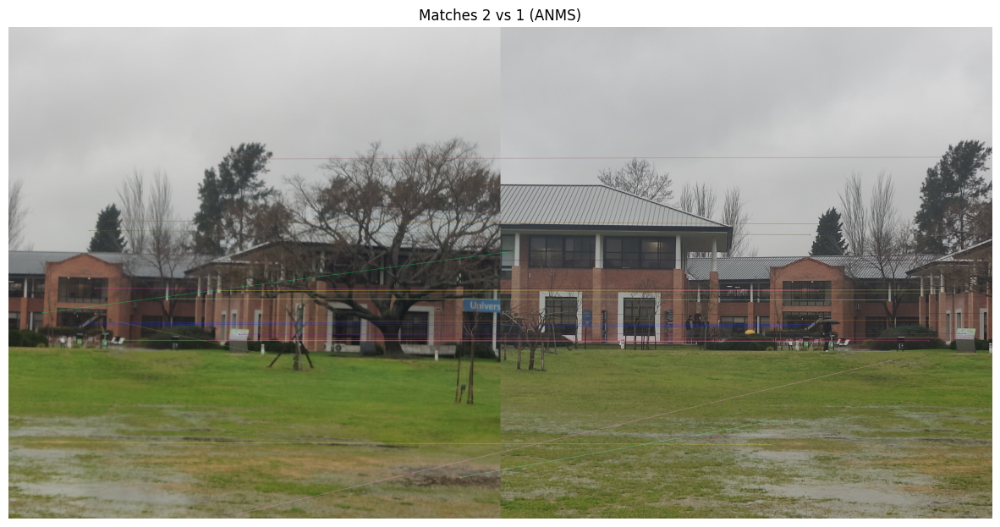

Imagen Cuadro 0: 1110 puntos tras ANMS
Imagen Cuadro 1: 1104 puntos tras ANMS
Imagen Cuadro 2: 1091 puntos tras ANMS
Matches entre Cuadro 0 y 1: 250
Matches entre Cuadro 2 y 1: 215


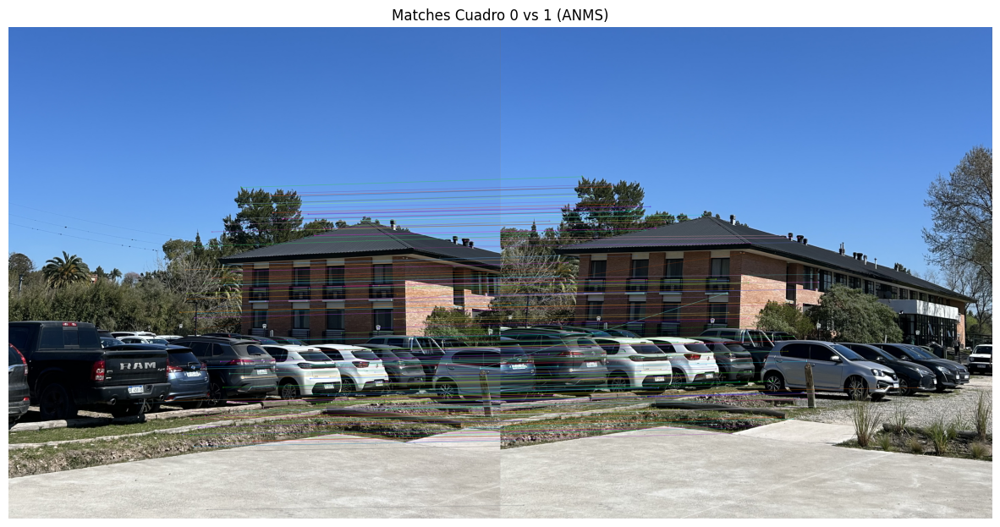

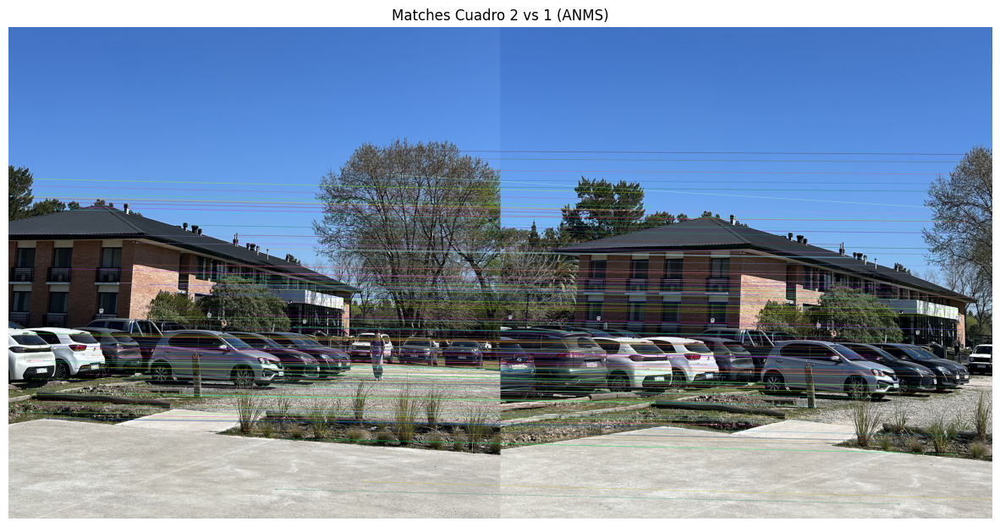

In [4]:
def filtrar_descriptores(keypoints, descriptores, keypoints_filtrados):
    """
    Retorna exactamente los descriptores correspondientes a los keypoints filtrados.
    Compara por coordenadas (redondeadas a int) en lugar de objetos KeyPoint.
    """
    coords_filtrados = {tuple(map(int, kp.pt)) for kp in keypoints_filtrados}
    kp_new, des_new = [], []
    for kp, des in zip(keypoints, descriptores):
        if tuple(map(int, kp.pt)) in coords_filtrados:
            kp_new.append(kp)
            des_new.append(des)
    return kp_new, np.array(des_new)

def match_features(desc1, desc2, metodo="SIFT", ratio=0.75,
                   use_ratio=True, use_cross_check=True):
    """
    Matching entre dos conjuntos de descriptores aplicando:
      - Lowe's ratio test
      - Cross-check
    Permite activar uno, otro, o ambos.
    Maneja el caso de que knnMatch devuelva menos de 2 matches.
    """
    if metodo.upper() == "SIFT":
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    else:
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=False)

    # KNN Matching (hasta 2 vecinos)
    matches = bf.knnMatch(desc1, desc2, k=2)

    # Lowe's ratio (si corresponde)
    buenos = []
    for m_n in matches:
        if len(m_n) < 2:
            continue  # evitar error cuando hay <2 vecinos
        m, n = m_n
        if not use_ratio or m.distance < ratio * n.distance:
            buenos.append(m)

    # Cross-check (si corresponde)
    if use_cross_check:
        matches_12 = {(m.queryIdx, m.trainIdx) for m in buenos}
        matches_back = bf.knnMatch(desc2, desc1, k=2)

        matches_21 = set()
        for m_n in matches_back:
            if len(m_n) < 2:
                continue
            m, n = m_n
            if not use_ratio or m.distance < ratio * n.distance:
                matches_21.add((m.trainIdx, m.queryIdx))

        interseccion = matches_12 & matches_21
        buenos = [m for m in buenos if (m.queryIdx, m.trainIdx) in interseccion]

    return buenos




def dibujar_matches(img1, kp1, img2, kp2, matches, max_matches, titulo="Matches"):
    """
    Visualiza las correspondencias.
    """
    img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:max_matches], None,
                                  flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(15, 8))
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(titulo)
    plt.axis("off")
    plt.show()

kp0_final, des0_final = filtrar_descriptores(kp0, des0, kp0_anms)
kp1_final, des1_final = filtrar_descriptores(kp1, des1, kp1_anms)
kp2_final, des2_final = filtrar_descriptores(kp2, des2, kp2_anms)



print(f"Imagen 0: {len(kp0_final)} puntos tras ANMS")
print(f"Imagen 1: {len(kp1_final)} puntos tras ANMS")
print(f"Imagen 2: {len(kp2_final)} puntos tras ANMS")



# Matching (usando la imagen 1 como "ancla")
matches01 = match_features(des0_final, des1_final, metodo="SIFT", ratio=0.75)
matches21 = match_features(des2_final, des1_final, metodo="SIFT", ratio=0.75)


print(f"Matches entre 0 y 1: {len(matches01)}")
print(f"Matches entre 2 y 1: {len(matches21)}")

# Visualizar algunos matches
dibujar_matches(udesa_0, kp0_final, udesa_1, kp1_final, matches01, 800, titulo="Matches 0 vs 1 (ANMS)")
dibujar_matches(udesa_2, kp2_final, udesa_1, kp1_final, matches21, 800, titulo="Matches 2 vs 1 (ANMS)")  

kp0_edi_final, des0_edi_final = filtrar_descriptores(kp0_edi, des0_edi, kp0_edi_anms)
kp1_edi_final, des1_edi_final = filtrar_descriptores(kp1_edi, des1_edi, kp1_edi_anms)
kp2_edi_final, des2_edi_final = filtrar_descriptores(kp2_edi, des2_edi, kp2_edi_anms)

print(f"Imagen Cuadro 0: {len(kp0_edi_final)} puntos tras ANMS")
print(f"Imagen Cuadro 1: {len(kp1_edi_final)} puntos tras ANMS")
print(f"Imagen Cuadro 2: {len(kp2_edi_final)} puntos tras ANMS")

matches01_edi = match_features(des0_edi_final, des1_edi_final, metodo="SIFT", ratio=0.75)
matches21_edi = match_features(des2_edi_final, des1_edi_final, metodo="SIFT", ratio=0.75)
print(f"Matches entre Cuadro 0 y 1: {len(matches01_edi)}")
print(f"Matches entre Cuadro 2 y 1: {len(matches21_edi)}")
# Visualizar algunos matches
dibujar_matches(edi_0, kp0_edi_final, edi_1, kp1_edi_final, matches01_edi, 800, titulo="Matches Cuadro 0 vs 1 (ANMS)")
dibujar_matches(edi_2, kp2_edi_final, edi_1, kp1_edi_final, matches21_edi, 800, titulo="Matches Cuadro 2 vs 1 (ANMS)")

In [5]:
def homo(points_2d):
  n = points_2d.shape[0]
  z = np.ones((n, 1))
  return np.hstack((points_2d, z))

def cart(h_points):
  x = h_points[:, 0]
  y = h_points[:, 1]
  z = h_points[:, 2]
  return np.stack((x/z, y/z)).T



def apply_transform(shape, T):
  h_ori = homo(shape)
  h_dst = np.dot(T, h_ori.T)
  dst = cart(h_dst.T)
  return dst


def dlt(ori, dst):
    """
    Estima homografía H con DLT (mínimos cuadrados).
    Admite >= 4 pares de puntos.
    """
    if ori.shape[0] < 4:
        raise ValueError("Se necesitan al menos 4 pares de puntos")

    A = []
    for (x, y), (xp, yp) in zip(ori, dst):
        A.append([-x, -y, -1, 0, 0, 0, x * xp, y * xp, xp])
        A.append([0, 0, 0, -x, -y, -1, x * yp, y * yp, yp])
    A = np.array(A)

    # Resolver A h = 0 con SVD (más estable)
    U, S, Vt = np.linalg.svd(A)
    h = Vt[-1]
    H = h.reshape(3,3)

    # Normalizar para que H[2,2] = 1
    return H / H[2,2]


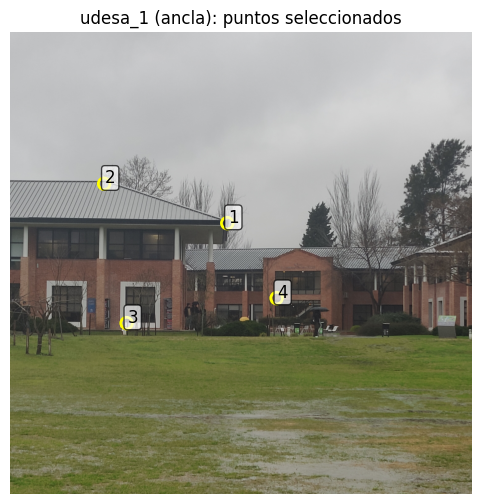

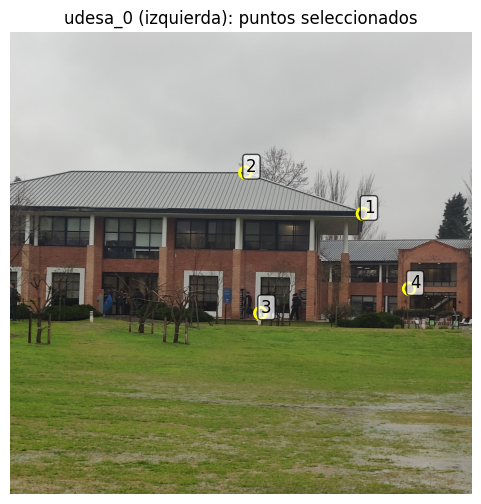

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


# =========================
# Utilidades de visualización
# =========================
def show_points(img_bgr, pts, title=""):
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(6,6))
    plt.imshow(img_rgb)
    plt.scatter(pts[:,0], pts[:,1], s=70, marker='o',
                facecolors='none', edgecolors='yellow', linewidths=2)
    for i, (x, y) in enumerate(pts):
        plt.text(x+5, y-5, f"{i+1}", fontsize=12, color='black',
                 bbox=dict(boxstyle="round,pad=0.2", fc="white", alpha=0.7))
    plt.title(title); plt.axis('off'); plt.show()

def reproject_points(pts_src, H):
    pts_h = np.c_[pts_src, np.ones(len(pts_src))]
    proj = (H @ pts_h.T).T
    proj = proj[:, :2] / proj[:, [2]]
    return proj

def show_points_compare(img_bgr, pts_ref, pts_est, title=""):
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(6,6))
    plt.imshow(img_rgb)
    plt.scatter(pts_ref[:,0], pts_ref[:,1], s=70, marker='o',
                facecolors='none', edgecolors='yellow', linewidths=2, label='Seleccionados')
    plt.scatter(pts_est[:,0], pts_est[:,1], s=50, marker='x',
                linewidths=2, label='Reproyectados')
    for (xr, yr), (xe, ye) in zip(pts_ref, pts_est):
        plt.plot([xr, xe], [yr, ye], linestyle='--', linewidth=1)
    for i, (x, y) in enumerate(pts_ref):
        plt.text(x+5, y-5, f"{i+1}", fontsize=12, color='black',
                 bbox=dict(boxstyle="round,pad=0.2", fc="white", alpha=0.7))
    plt.title(title); plt.legend(loc='lower right'); plt.axis('off'); plt.show()

# =========================
# TUS PUNTOS
# =========================

ancla = np.array([
    (1410.21, 1240.57),
    (610.70, 984.89),
    (756.81, 1889.92),
    (1730.83, 1727.58)
])


izq = np.array([
    (2290.90, 1179.69),
    (1527.91, 911.84),
    (1625.31, 1824.99),
    (2591.22, 1666.71)
])


# =========================
# PLOTS
# =========================
# Mostrar puntos en cada imagen
show_points(udesa_1, ancla, title="udesa_1 (ancla): puntos seleccionados")
show_points(udesa_0, izq, title="udesa_0 (izquierda): puntos seleccionados")




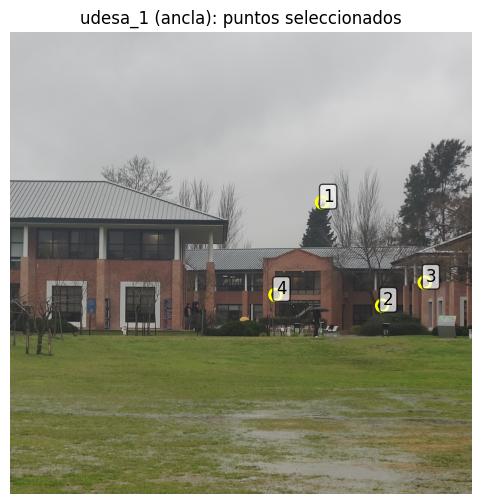

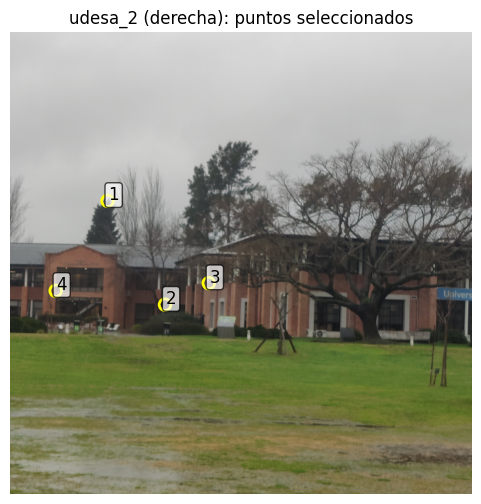

In [7]:
ancla2 = np.array([
    (2026, 1106),
    (2416, 1776),
    (2693, 1626),
    (1723, 1706)
])


der = np.array([
    (633, 1096),
    (1006, 1770),
    (1290, 1630),
    (296, 1680)
])

show_points(udesa_1, ancla2, title="udesa_1 (ancla): puntos seleccionados")
show_points(udesa_2, der, title="udesa_2 (derecha): puntos seleccionados")

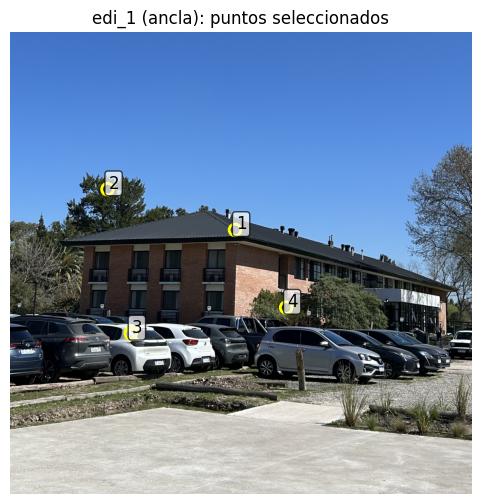

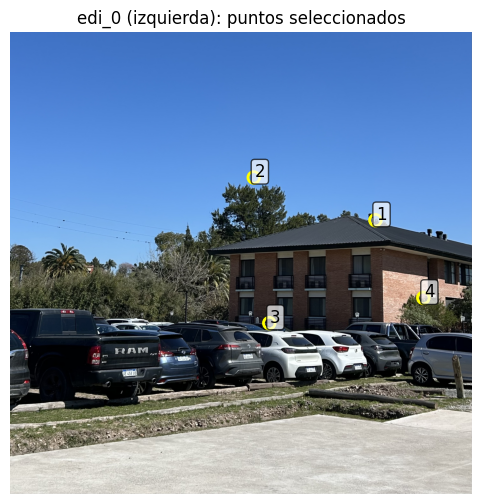

In [8]:

ancla_cuadro = np.array([
    (1410.21, 1240.57),
    (610.70, 984.89),
    (756.81, 1889.92),
    (1730.83, 1727.58)
])


izq_cuadro = np.array([
    (2290.90, 1179.69),
    (1527.91, 911.84),
    (1625.31, 1824.99),
    (2591.22, 1666.71)
])


# =========================
# PLOTS
# =========================
# Mostrar puntos en cada imagen
show_points(edi_1, ancla_cuadro, title="edi_1 (ancla): puntos seleccionados")
show_points(edi_0, izq_cuadro, title="edi_0 (izquierda): puntos seleccionados")


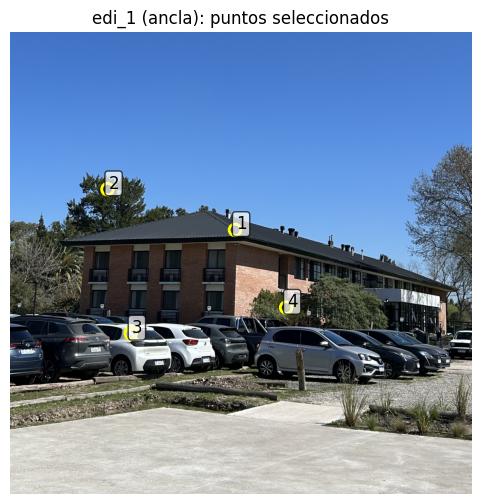

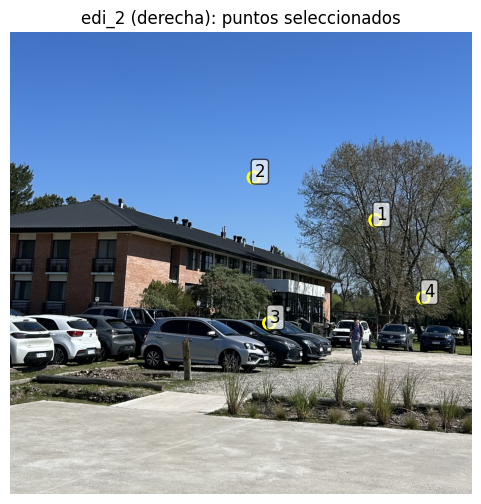

In [9]:
ancla_cuadro2 = np.array([
    (1410.21, 1240.57),
    (610.70, 984.89),
    (756.81, 1889.92),
    (1730.83, 1727.58)
])


der_cuadro = np.array([
    (2290.90, 1179.69),
    (1527.91, 911.84),
    (1625.31, 1824.99),
    (2591.22, 1666.71)
])


# =========================
# PLOTS
# =========================
# Mostrar puntos en cada imagen
show_points(edi_1, ancla_cuadro2, title="edi_1 (ancla): puntos seleccionados")
show_points(edi_2, der_cuadro, title="edi_2 (derecha): puntos seleccionados")


In [10]:
import numpy as np
import cv2  # solo para la homografía final (sin RANSAC)

# -----------------------------------
# 2) Utilidades de error / degenerado
# -----------------------------------
def reprojection_errors(H, pts_src, pts_dst):
    """
    Error de reproyección unidireccional (a la imagen destino), en píxeles.
    e_i = || dst_i - norm(H * src_i) ||_2
    """
    n = len(pts_src)
    src_h = np.c_[pts_src, np.ones(n)]
    proj  = (H @ src_h.T).T
    proj  = proj[:, :2] / proj[:, [2]]
    return np.linalg.norm(pts_dst - proj, axis=1)

def symmetric_transfer_error(H, pts_src, pts_dst):
    """
    Error simétrico: e = ||x' - Hx|| + ||x - H^{-1}x'||.
    Un poco más caro pero más estable.
    """
    e1 = reprojection_errors(H, pts_src, pts_dst)
    try:
        Hinv = np.linalg.inv(H)
        e2 = reprojection_errors(Hinv, pts_dst, pts_src)
    except np.linalg.LinAlgError:
        e2 = np.full_like(e1, np.inf)
    return e1 + e2

def _non_degenerate(sample_src, sample_dst, tol=1e-3, min_area=10.0):
    """
    Evita muestras degeneradas:
    - chequea rango >= 3 (no colineales)
    - chequea que el área del cuadrilátero formado sea mayor a min_area
    """
    def rank3(pts):
        M = np.c_[pts, np.ones(len(pts))]
        return np.linalg.matrix_rank(M, tol)

    def area_quad(pts):
        # área aproximada del polígono con 4 puntos
        x = pts[:,0]; y = pts[:,1]
        return 0.5 * abs(
            x[0]*y[1] + x[1]*y[2] + x[2]*y[3] + x[3]*y[0]
            - y[0]*x[1] - y[1]*x[2] - y[2]*x[3] - y[3]*x[0]
        )

    return (rank3(sample_src) >= 3 and
            rank3(sample_dst) >= 3 and
            area_quad(sample_src) > min_area and
            area_quad(sample_dst) > min_area)

# -----------------------------
# 3) RANSAC para homografía (sin OpenCV)
# -----------------------------
def ransac_homography(pts_src, pts_dst, thresh=3.0, max_trials=5000,
                      confidence=0.999, use_symmetric_error=True, seed=None):
    """
    Implementación RANSAC para homografía.
    Devuelve:
      - H_best (3x3)
      - inlier_mask (bool de tamaño N)
    """
    assert pts_src.shape == pts_dst.shape and pts_src.shape[0] >= 4
    N = len(pts_src)
    rng = np.random.default_rng(seed)

    best_inliers = None
    best_num = 0
    best_err_sum = np.inf

    s = 4  # número mínimo de puntos
    log1p = np.log

    trials = max_trials
    i = 0
    while i < trials:
        i += 1
        idx = rng.choice(N, size=s, replace=False)
        sample_src = pts_src[idx]
        sample_dst = pts_dst[idx]

        if not _non_degenerate(sample_src, sample_dst):
            continue

        try:
            H = dlt(sample_src, sample_dst)  # tu DLT
        except np.linalg.LinAlgError:
            continue

        # calcular errores
        if use_symmetric_error:
            errs = symmetric_transfer_error(H, pts_src, pts_dst)
        else:
            errs = reprojection_errors(H, pts_src, pts_dst)

        inliers = errs < thresh
        num_inl = int(inliers.sum())

        if num_inl > best_num or (num_inl == best_num and errs[inliers].sum() < best_err_sum):
            best_num = num_inl
            best_inliers = inliers
            best_err_sum = errs[inliers].sum()

            # early stopping adaptativo
            w = max(1e-6, num_inl / N)
            num = 1 - confidence
            den = 1 - w ** s
            if den <= 1e-12:
                trials = i
            else:
                trials = min(trials, int(np.ceil(log1p(num) / log1p(den))))
                trials = max(trials, i + 1)

    if best_inliers is None or best_num < 4:
        raise RuntimeError("RANSAC no encontró un modelo válido.")

    # recalcular homografía con TODOS los inliers
    H_final = dlt(pts_src[best_inliers], pts_dst[best_inliers])
    H_final /= H_final[2,2]  # normalizar

    return H_final, best_inliers
# --------------------------------------------
# 4) Cálculo final con OpenCV (opcional, pedido)
# --------------------------------------------
def homography_final_opencv(pts_src, pts_dst, inlier_mask):
    """
    Homografía final usando SOLO los inliers, con cv2.findHomography sin RANSAC.
    (Esto es lo permitido por el enunciado.)
    """
    H, _ = cv2.findHomography(pts_src[inlier_mask], pts_dst[inlier_mask], method=0)
    # Normalizamos por si acaso
    return H / H[2, 2]


In [11]:
#calculo de las homografias con dlt
H01_manual = dlt(izq, ancla)
H02_manual = dlt(der, ancla2)

#normalizar
H01_manual = H01_manual / H01_manual[2, 2]
H02_manual = H02_manual / H02_manual[2, 2]

   

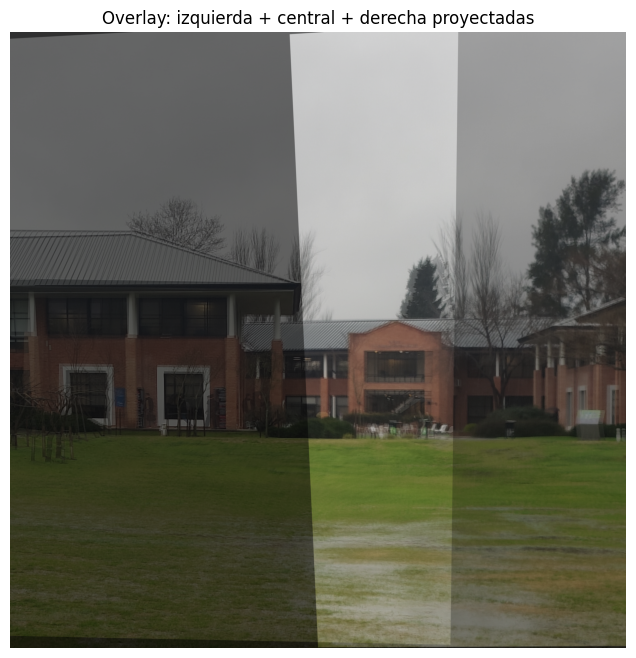

In [12]:
# Warp de las imágenes izquierda y derecha hacia la central
h, w = udesa_1.shape[:2]
img_left_warped  = cv2.warpPerspective(udesa_0, H01_manual, (w, h))
img_right_warped = cv2.warpPerspective(udesa_2, H02_manual, (w, h))

# Convertir todas a RGB para graficar en matplotlib
base  = cv2.cvtColor(udesa_1, cv2.COLOR_BGR2RGB)
left  = cv2.cvtColor(img_left_warped, cv2.COLOR_BGR2RGB)
right = cv2.cvtColor(img_right_warped, cv2.COLOR_BGR2RGB)

# Mezclar las tres con transparencia
alpha = 0.5
beta  = 0.5
gamma = 0.5

overlay = cv2.addWeighted(base, 1-alpha, left, alpha, 0)
overlay = cv2.addWeighted(overlay, 1-beta, right, beta, 0)

# Mostrar resultado
plt.figure(figsize=(14,8))
plt.imshow(overlay)
plt.title("Overlay: izquierda + central + derecha proyectadas")
plt.axis("off")
plt.show()



# 3.5 RANSAC para eliminacion de otuliers y estimación de homografías


Homografía 0→1 (con RANSAC):
 [[ 1.05663570e+00  9.82758459e-03 -9.66548841e+02]
 [ 1.52379688e-02  1.03264824e+00  2.93571111e+01]
 [ 1.53253736e-05  7.29273567e-07  1.00000000e+00]]
Matches 0 vs 1: 53 inliers, 40 outliers (total 93)


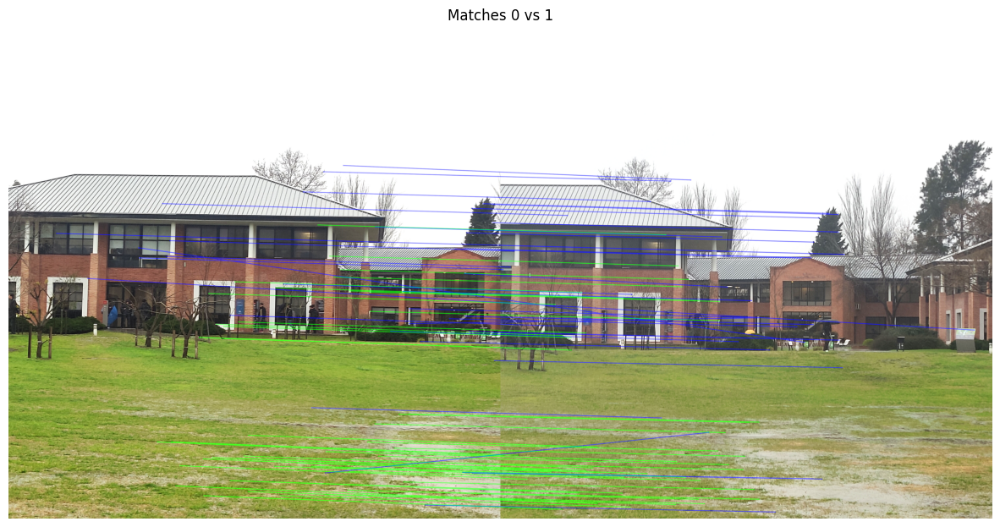

Homografía 2→1 (con RANSAC):
 [[ 8.61451793e-01  2.32513933e-02  1.40212945e+03]
 [-9.81975911e-02  9.46065507e-01  1.20410949e+02]
 [-4.10265730e-05 -1.57875397e-06  1.00000000e+00]]
Matches 2 vs 1: 10 inliers, 15 outliers (total 25)


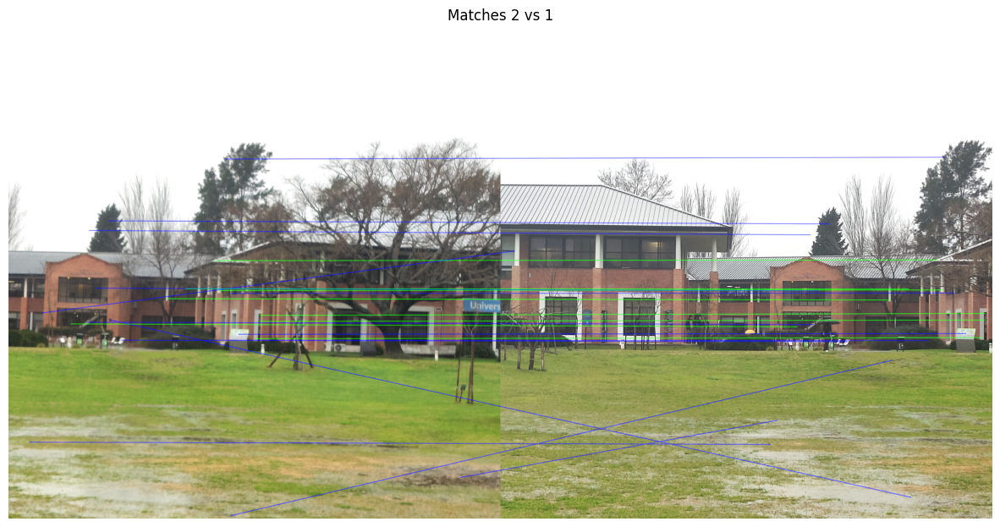

In [13]:
def extraer_puntos(matches, kp1, kp2):
    """Convierte matches en arrays de puntos (src, dst)."""
    pts_src = np.float32([kp1[m.queryIdx].pt for m in matches])
    pts_dst = np.float32([kp2[m.trainIdx].pt for m in matches])
    return pts_src, pts_dst

def dibujar_inliers(img1, kp1, img2, kp2, matches, inlier_mask, titulo="Matches con RANSAC"):
    """
    Dibuja inliers (verde) y outliers (rojo).
    """
    inliers  = [m for i, m in enumerate(matches) if inlier_mask[i]]
    outliers = [m for i, m in enumerate(matches) if not inlier_mask[i]]

    print(f"{titulo}: {len(inliers)} inliers, {len(outliers)} outliers (total {len(matches)})")

    img_inliers  = cv2.drawMatches(img1, kp1, img2, kp2, inliers, None,
                                matchColor=(0,255,0),  # verde fuerte
                                singlePointColor=None,
                                matchesThickness=3,
                                flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    img_outliers = cv2.drawMatches(img1, kp1, img2, kp2, outliers, None,
                                matchColor=(255,0,0),  # rojo fuerte
                                singlePointColor=None,
                                matchesThickness=3,
                                flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    # Fusionar ambas imágenes en un solo canvas
    overlay = cv2.addWeighted(img_inliers, 0.7, img_outliers, 0.7, 0)

    plt.figure(figsize=(15,8))
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title(titulo)
    plt.axis("off")
    plt.show()

# -------------------------------
# Ejemplo con matches01 (izq vs ancla)
# -------------------------------
pts_src01, pts_dst01 = extraer_puntos(matches01, kp0_final, kp1_final)

H01_ransac, mask01 = ransac_homography(pts_src01, pts_dst01, thresh=3.0, max_trials=5000)
H01_final = homography_final_opencv(pts_src01, pts_dst01, mask01)

print("Homografía 0→1 (con RANSAC):\n", H01_final)

dibujar_inliers(udesa_0, kp0_final, udesa_1, kp1_final, matches01, mask01,
                titulo="Matches 0 vs 1")

# -------------------------------
# Ejemplo con matches21 (der vs ancla)
# -------------------------------
pts_src21, pts_dst21 = extraer_puntos(matches21, kp2_final, kp1_final)

H21_ransac, mask21 = ransac_homography(pts_src21, pts_dst21, thresh=4.5, max_trials=5000)
H21_final = homography_final_opencv(pts_src21, pts_dst21, mask21)

print("Homografía 2→1 (con RANSAC):\n", H21_final)

dibujar_inliers(udesa_2, kp2_final, udesa_1, kp1_final, matches21, mask21,
                titulo="Matches 2 vs 1")


Homografía 0→1 (con RANSAC):
 [[ 1.10924140e+00 -7.31288322e-02 -9.37123720e+02]
 [ 7.59306726e-02  1.06620967e+00 -1.80875754e+02]
 [ 3.85632120e-05 -1.04355682e-06  1.00000000e+00]]
Matches 0 vs 1: 104 inliers, 146 outliers (total 250)


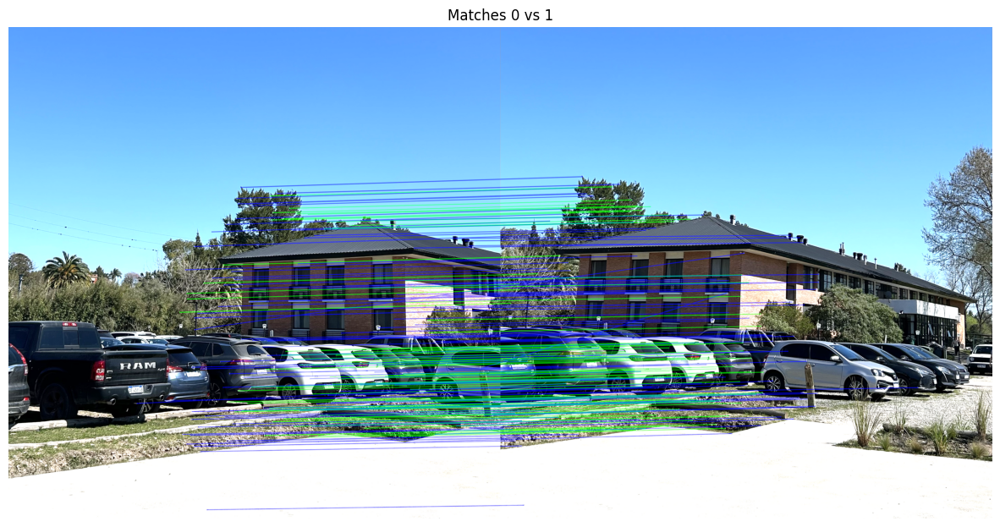

Homografía 2→1 (con RANSAC):
 [[ 9.07595346e-01  6.23637196e-02  6.28762020e+02]
 [-6.06473795e-02  9.78934487e-01  1.05301523e+02]
 [-3.57007319e-05  3.52616008e-06  1.00000000e+00]]
Matches 2 vs 1: 82 inliers, 133 outliers (total 215)


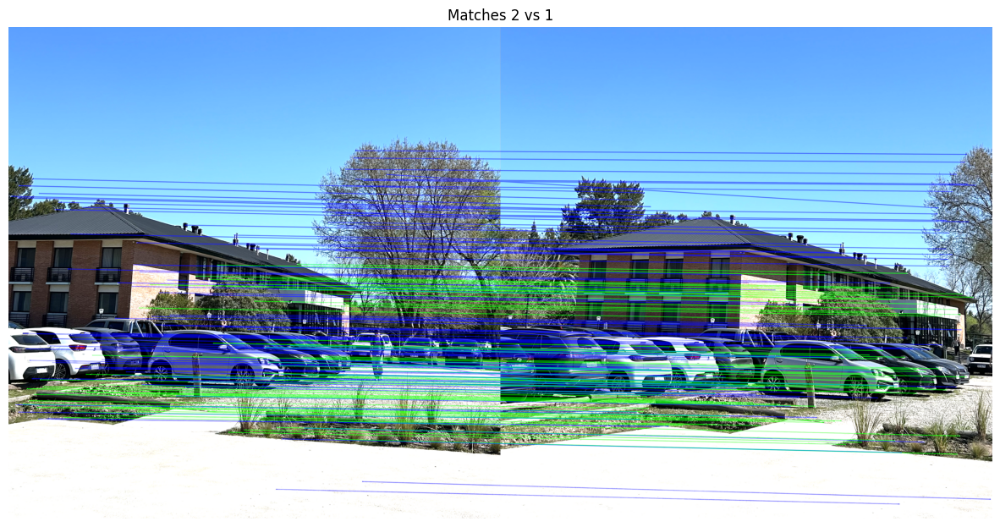

In [14]:
pts_src01_edi, pts_dst01_edi = extraer_puntos(matches01_edi, kp0_edi_final, kp1_edi_final)

H01_ransac_edi, mask01_edi = ransac_homography(pts_src01_edi, pts_dst01_edi, thresh=3.5, max_trials=5000)
H01_final_edi = homography_final_opencv(pts_src01_edi, pts_dst01_edi, mask01_edi)

print("Homografía 0→1 (con RANSAC):\n", H01_final_edi)

dibujar_inliers(edi_0, kp0_edi_final, edi_1, kp1_edi_final, matches01_edi, mask01_edi,
                titulo="Matches 0 vs 1")

# -------------------------------
# Ejemplo con matches21 (der vs ancla)
# -------------------------------
pts_src21_edi, pts_dst21_edi = extraer_puntos(matches21_edi, kp2_edi_final, kp1_edi_final)

H21_ransac_edi, mask21_edi = ransac_homography(pts_src21_edi, pts_dst21_edi, thresh=3.8, max_trials=5000)
H21_final_edi = homography_final_opencv(pts_src21_edi, pts_dst21_edi, mask21_edi)

print("Homografía 2→1 (con RANSAC):\n", H21_final_edi)

dibujar_inliers(edi_2, kp2_edi_final, edi_1, kp1_edi_final, matches21_edi, mask21_edi,
                titulo="Matches 2 vs 1")

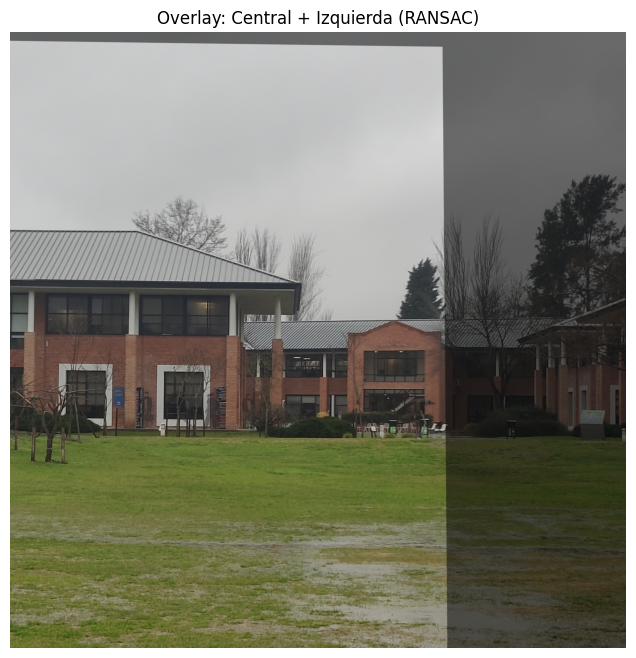

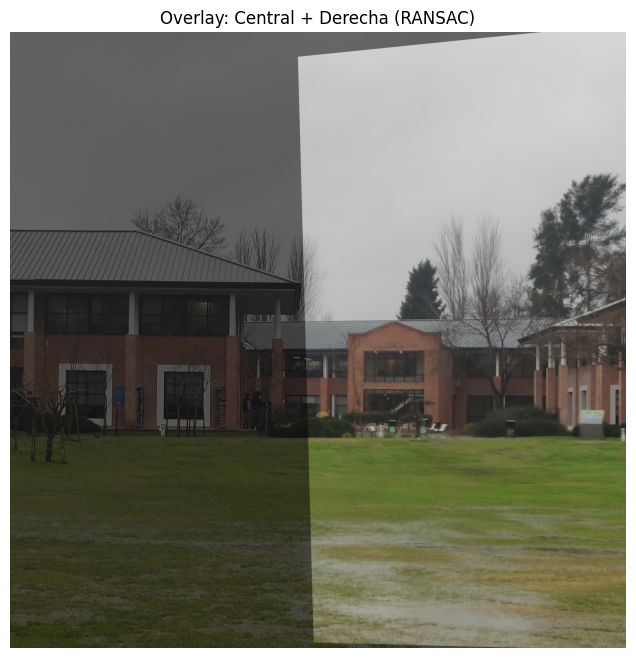

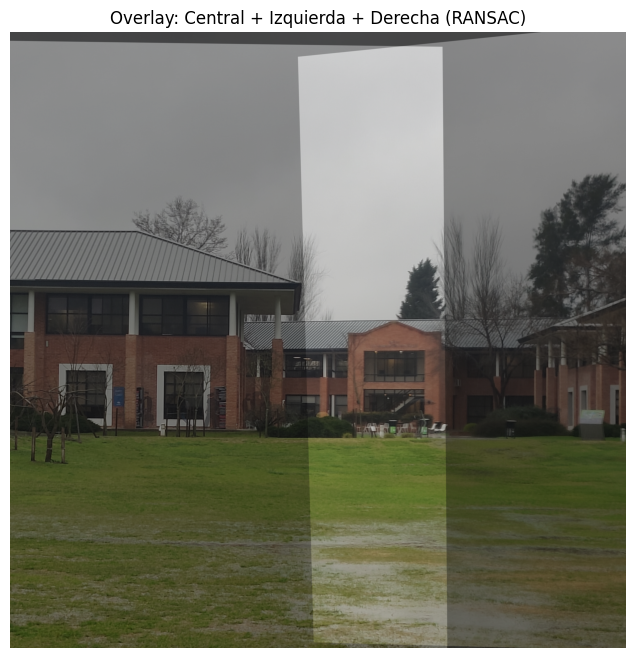

In [15]:
# Tamaño de la imagen ancla (udesa_1)
h, w = udesa_1.shape[:2]

# Warp de izquierda y derecha hacia la central con las homografías de RANSAC
img_left_warped  = cv2.warpPerspective(udesa_0, H01_final, (w, h))
img_right_warped = cv2.warpPerspective(udesa_2, H21_final, (w, h))

# Convertir a RGB para mostrar con matplotlib
img_central = cv2.cvtColor(udesa_1, cv2.COLOR_BGR2RGB)
left_rgb    = cv2.cvtColor(img_left_warped, cv2.COLOR_BGR2RGB)
right_rgb   = cv2.cvtColor(img_right_warped, cv2.COLOR_BGR2RGB)

# --- Overlay izquierda + central ---
alpha = 0.5
overlay_left = cv2.addWeighted(img_central, 1-alpha, left_rgb, alpha, 0)
plt.figure(figsize=(12,8))
plt.imshow(overlay_left)
plt.title("Overlay: Central + Izquierda (RANSAC)")
plt.axis("off")
plt.show()

# --- Overlay derecha + central ---
overlay_right = cv2.addWeighted(img_central, 1-alpha, right_rgb, alpha, 0)
plt.figure(figsize=(12,8))
plt.imshow(overlay_right)
plt.title("Overlay: Central + Derecha (RANSAC)")
plt.axis("off")
plt.show()

# --- Overlay de las tres ---
overlay_three = cv2.addWeighted(img_central, 0.5, left_rgb, 0.5, 0)
overlay_three = cv2.addWeighted(overlay_three, 0.7, right_rgb, 0.3, 0)
plt.figure(figsize=(14,8))
plt.imshow(overlay_three)
plt.title("Overlay: Central + Izquierda + Derecha (RANSAC)")
plt.axis("off")
plt.show()


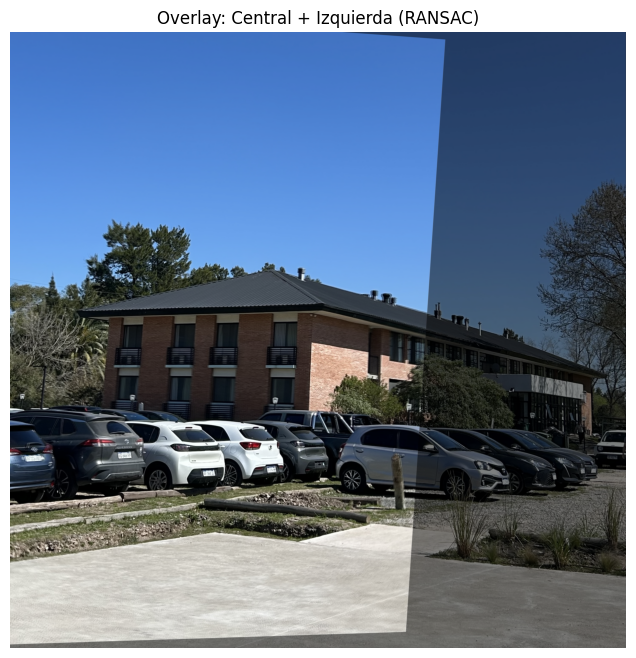

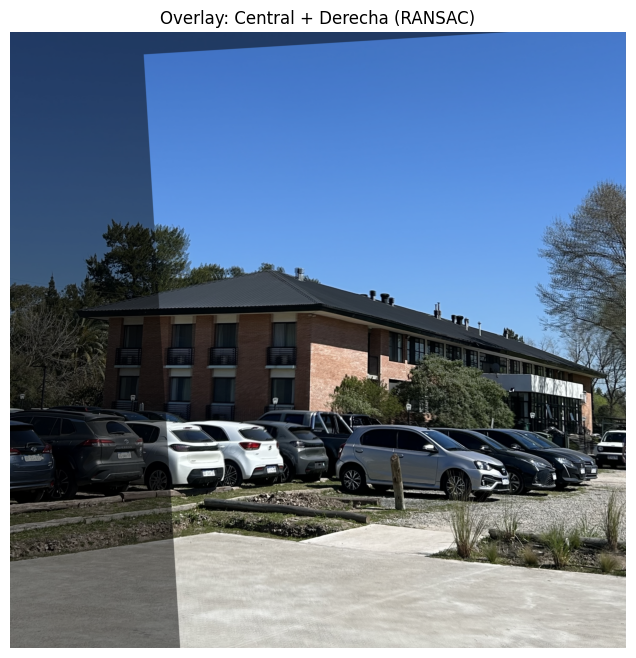

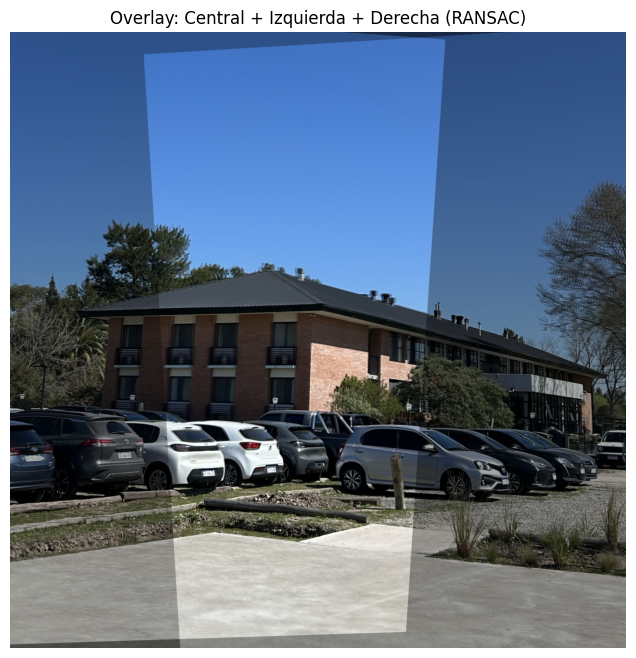

In [16]:
# Tamaño de la imagen ancla (cuadro_1)
h, w = edi_1.shape[:2]

# Warp de izquierda y derecha hacia la central con las homografías de RANSAC
img_left_warped  = cv2.warpPerspective(edi_0, H01_final_edi, (w, h))
img_right_warped = cv2.warpPerspective(edi_2, H21_final_edi, (w, h))

# Convertir a RGB para mostrar con matplotlib
img_central = cv2.cvtColor(edi_1, cv2.COLOR_BGR2RGB)
left_rgb    = cv2.cvtColor(img_left_warped, cv2.COLOR_BGR2RGB)
right_rgb   = cv2.cvtColor(img_right_warped, cv2.COLOR_BGR2RGB)

# --- Overlay izquierda + central ---
alpha = 0.5
overlay_left = cv2.addWeighted(img_central, 1-alpha, left_rgb, alpha, 0)
plt.figure(figsize=(12,8))
plt.imshow(overlay_left)
plt.title("Overlay: Central + Izquierda (RANSAC)")
plt.axis("off")
plt.show()

# --- Overlay derecha + central ---
overlay_right = cv2.addWeighted(img_central, 1-alpha, right_rgb, alpha, 0)
plt.figure(figsize=(12,8))
plt.imshow(overlay_right)
plt.title("Overlay: Central + Derecha (RANSAC)")
plt.axis("off")
plt.show()

# --- Overlay de las tres ---
overlay_three = cv2.addWeighted(img_central, 0.5, left_rgb, 0.5, 0)
overlay_three = cv2.addWeighted(overlay_three, 0.7, right_rgb, 0.3, 0)
plt.figure(figsize=(14,8))
plt.imshow(overlay_three)
plt.title("Overlay: Central + Izquierda + Derecha (RANSAC)")
plt.axis("off")
plt.show()


# 3.6 Cálculo de tamaño óptimo para imágen final

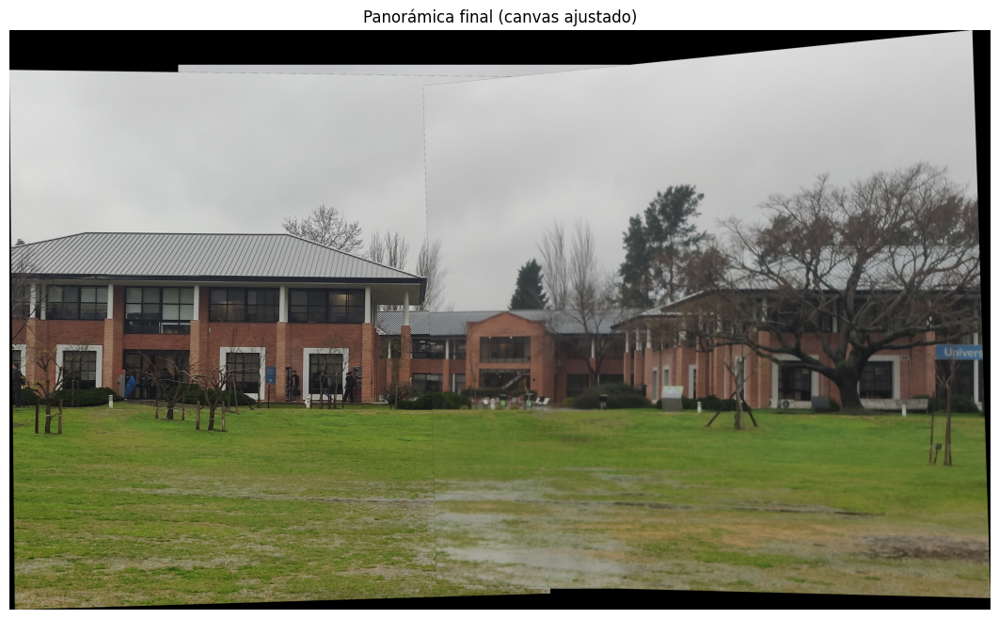

In [17]:
def calcular_canvas_optimo(img_anchor, img_left, img_right, H_left, H_right):
    h, w = img_anchor.shape[:2]

    # Esquinas
    corners_anchor = np.array([[0,0],[w,0],[w,h],[0,h]], dtype=np.float32).reshape(-1,1,2)
    corners_left   = np.array([[0,0],[img_left.shape[1],0],[img_left.shape[1],img_left.shape[0]],[0,img_left.shape[0]]], dtype=np.float32).reshape(-1,1,2)
    corners_right  = np.array([[0,0],[img_right.shape[1],0],[img_right.shape[1],img_right.shape[0]],[0,img_right.shape[0]]], dtype=np.float32).reshape(-1,1,2)

    # Proyección
    warped_left  = cv2.perspectiveTransform(corners_left,  H_left)
    warped_right = cv2.perspectiveTransform(corners_right, H_right)

    # Unir todas las esquinas
    all_corners = np.vstack((corners_anchor, warped_left, warped_right))
    [xmin, ymin] = np.int32(all_corners.min(axis=0).ravel())
    [xmax, ymax] = np.int32(all_corners.max(axis=0).ravel())

    # Traslación
    tx, ty = -xmin, -ymin
    T = np.array([[1,0,tx],[0,1,ty],[0,0,1]], dtype=np.float32)

    size = (xmax-xmin, ymax-ymin)

    return T, size


T, size = calcular_canvas_optimo(udesa_1, udesa_0, udesa_2, H01_final, H21_final)

warp_left  = cv2.warpPerspective(udesa_0, T @ H01_final, size)
warp_right = cv2.warpPerspective(udesa_2, T @ H21_final, size)
warp_anchor = cv2.warpPerspective(udesa_1, T, size)  # ancla también trasladada

canvas = np.zeros_like(warp_anchor)
canvas = warp_anchor.copy()

# Superponer izquierda (no pisar negros)
mask_left = (warp_left > 0)
canvas[mask_left] = warp_left[mask_left]

# Superponer derecha (no pisar negros)
mask_right = (warp_right > 0)
canvas[mask_right] = warp_right[mask_right]

plt.figure(figsize=(15,8))
plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
plt.title("Panorámica final (canvas ajustado)")
plt.axis("off")
plt.show()



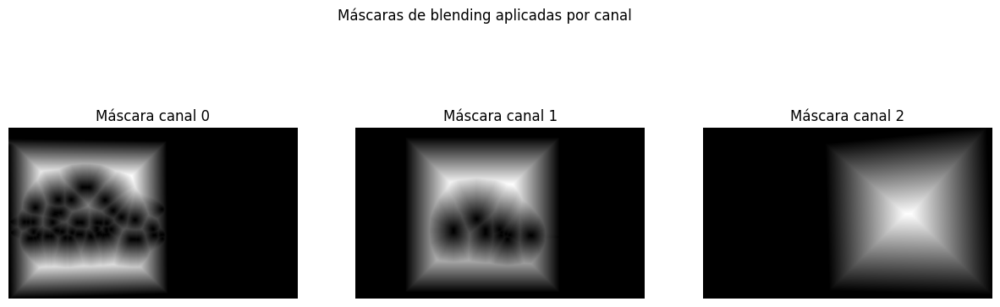

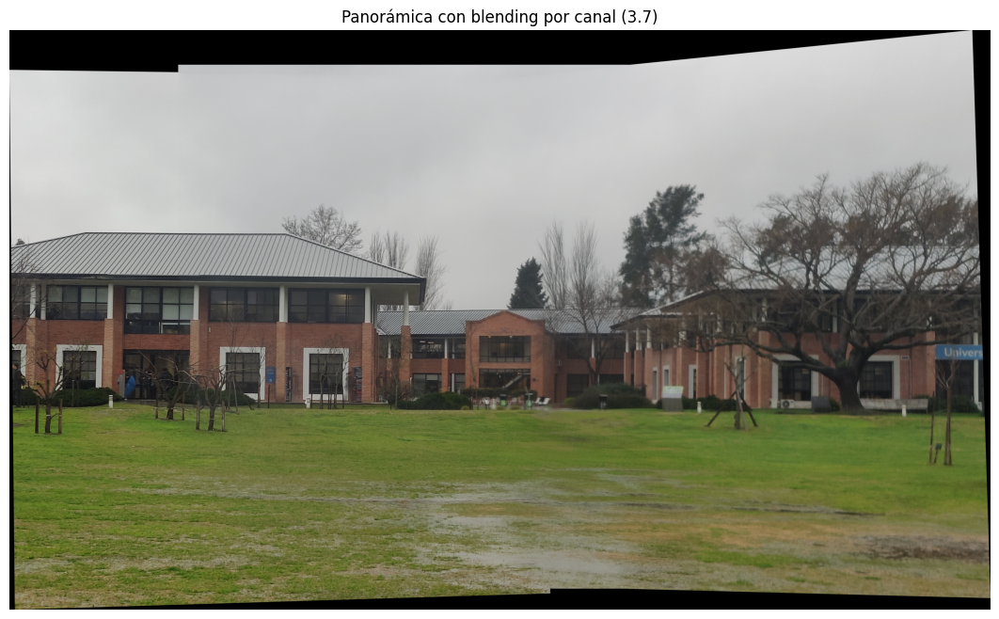

In [18]:
def blend_images_por_canal(warps, mostrar=True):
    """
    Aplica blending canal por canal, usando distanceTransform como máscara.
    """
    h, w = warps[0].shape[:2]
    acc_r = np.zeros((h, w), np.float32)
    acc_g = np.zeros((h, w), np.float32)
    acc_b = np.zeros((h, w), np.float32)
    weights_sum = np.zeros((h, w), np.float32)

    mascaras = []

    for warp in warps:
        # máscara binaria de la imagen warp
        mask = (cv2.cvtColor(warp, cv2.COLOR_BGR2GRAY) > 0).astype(np.uint8)
        if np.count_nonzero(mask) == 0:
            continue

        # máscara degradada
        dist = cv2.distanceTransform(mask, cv2.DIST_L2, 5)
        dist = cv2.normalize(dist, None, 0, 1.0, cv2.NORM_MINMAX)
        mascaras.append(dist)

        # separar canales
        r, g, b = cv2.split(warp.astype(np.float32))

        # aplicar máscara canal por canal
        acc_r += r * dist
        acc_g += g * dist
        acc_b += b * dist

        weights_sum += dist

    # evitar división por cero
    weights_sum[weights_sum == 0] = 1.0

    # normalizar cada canal
    r_final = acc_r / weights_sum
    g_final = acc_g / weights_sum
    b_final = acc_b / weights_sum

    # unir en una sola imagen
    panorama = cv2.merge([r_final, g_final, b_final]).astype(np.uint8)

    if mostrar:
        fig, axes = plt.subplots(1, len(mascaras), figsize=(15,5))
        for i, W in enumerate(mascaras):
            axes[i].imshow(W, cmap="gray")
            axes[i].set_title(f"Máscara canal {i}")
            axes[i].axis("off")
        plt.suptitle("Máscaras de blending aplicadas por canal")
        plt.show()

        plt.figure(figsize=(15,8))
        plt.imshow(cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB))
        plt.title("Panorámica con blending por canal (3.7)")
        plt.axis("off")
        plt.show()

    return panorama

# --- Uso con tus imágenes warpadas ---

panorama_final = blend_images_por_canal([warp_left, warp_anchor, warp_right], mostrar=True)


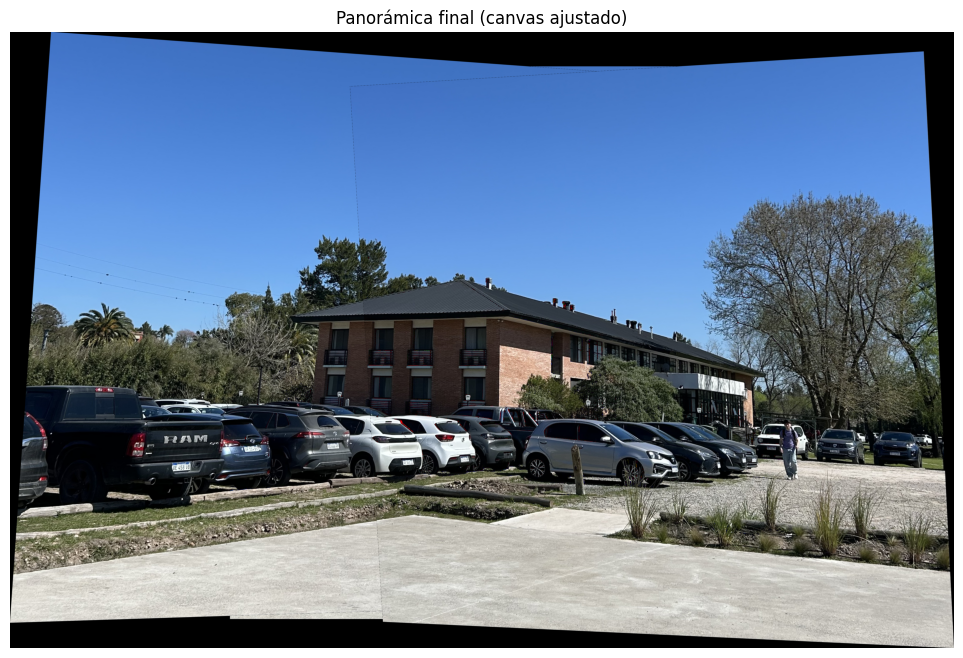

In [19]:
T, size = calcular_canvas_optimo(edi_1, edi_0, edi_2, H01_final_edi, H21_final_edi)

warp_left  = cv2.warpPerspective(edi_0, T @ H01_final_edi, size)
warp_right = cv2.warpPerspective(edi_2, T @ H21_final_edi, size)
warp_anchor = cv2.warpPerspective(edi_1, T, size)  # ancla también trasladada

canvas = np.zeros_like(warp_anchor)
canvas = warp_anchor.copy()

# Superponer izquierda (no pisar negros)
mask_left = (warp_left > 0)
canvas[mask_left] = warp_left[mask_left]

# Superponer derecha (no pisar negros)
mask_right = (warp_right > 0)
canvas[mask_right] = warp_right[mask_right]

plt.figure(figsize=(15,8))
plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
plt.title("Panorámica final (canvas ajustado)")
plt.axis("off")
plt.show()

# 3.7 Stiching y Blending

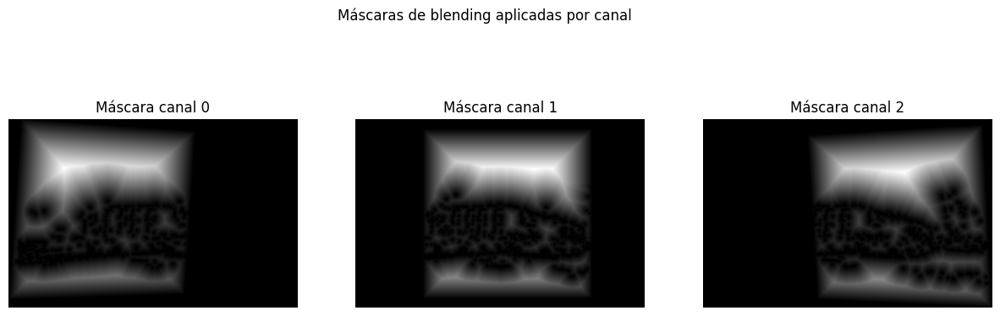

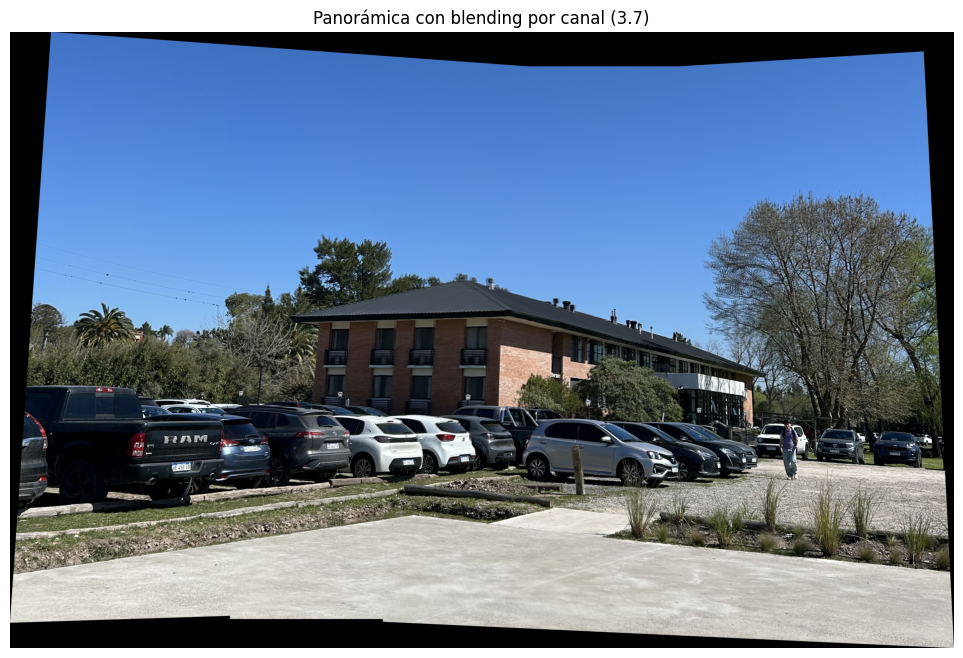

In [20]:
def blend_images_por_canal(warps, mostrar=True):
    """
    Aplica blending canal por canal, usando distanceTransform como máscara.
    """
    h, w = warps[0].shape[:2]
    acc_r = np.zeros((h, w), np.float32)
    acc_g = np.zeros((h, w), np.float32)
    acc_b = np.zeros((h, w), np.float32)
    weights_sum = np.zeros((h, w), np.float32)

    mascaras = []

    for warp in warps:
        # máscara binaria de la imagen warp
        mask = (cv2.cvtColor(warp, cv2.COLOR_BGR2GRAY) > 0).astype(np.uint8)
        if np.count_nonzero(mask) == 0:
            continue

        # máscara degradada
        dist = cv2.distanceTransform(mask, cv2.DIST_L2, 5)
        dist = cv2.normalize(dist, None, 0, 1.0, cv2.NORM_MINMAX)
        mascaras.append(dist)

        # separar canales
        r, g, b = cv2.split(warp.astype(np.float32))

        # aplicar máscara canal por canal
        acc_r += r * dist
        acc_g += g * dist
        acc_b += b * dist

        weights_sum += dist

    # evitar división por cero
    weights_sum[weights_sum == 0] = 1.0

    # normalizar cada canal
    r_final = acc_r / weights_sum
    g_final = acc_g / weights_sum
    b_final = acc_b / weights_sum

    # unir en una sola imagen
    panorama = cv2.merge([r_final, g_final, b_final]).astype(np.uint8)

    if mostrar:
        fig, axes = plt.subplots(1, len(mascaras), figsize=(15,5))
        for i, W in enumerate(mascaras):
            axes[i].imshow(W, cmap="gray")
            axes[i].set_title(f"Máscara canal {i}")
            axes[i].axis("off")
        plt.suptitle("Máscaras de blending aplicadas por canal")
        plt.show()

        plt.figure(figsize=(15,8))
        plt.imshow(cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB))
        plt.title("Panorámica con blending por canal (3.7)")
        plt.axis("off")
        plt.show()

    return panorama

# --- Uso con tus imágenes warpadas ---

panorama_final = blend_images_por_canal([warp_left, warp_anchor, warp_right], mostrar=True)
